In [1]:
import glob
import cv2
import numpy as np
import matplotlib.pyplot as plt
import imutils
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report
from sklearn.decomposition import PCA, KernelPCA
from sklearn.ensemble import RandomForestClassifier

In [2]:
def crop_brain(image):
    
    # Convert the image to grayscale, and blur it slightly
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = cv2.GaussianBlur(gray, (5, 5), 0)
    
    thresh = cv2.threshold(gray, 45, 255, cv2.THRESH_BINARY)[1]
    thresh = cv2.erode(thresh, None, iterations=2)
    thresh = cv2.dilate(thresh, None, iterations=2)

    # Find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)
    # extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    
    # crop new image out of the original image using the four extreme points (left, right, top, bottom)
    new_image = image[extTop[1]:extBot[1], extLeft[0]:extRight[0]]            
    
    return new_image

In [3]:
def load_images(folder):
    types_img= ['png','PNG', 'jpg',  'JPG', 'gif']    # Add image formats here
    cv_img = []
    for type_img in types_img:
        for file in glob.glob('data/'+folder+'/*.'+type_img):
            img = cv2.imread(file)
            if img is not None:
                image = crop_brain(img)
                image_resize = cv2.resize(image, (128, 128))
                gray = cv2.cvtColor(image_resize, cv2.COLOR_BGR2GRAY)
                cv_img.append(gray)
    return cv_img

In [4]:
mypath='yes'
tumor_yes = load_images(mypath)
len_tumor_yes = len(tumor_yes)
print(len_tumor_yes)

151


****************************************** tumor dataset (target = yes) ******************************************


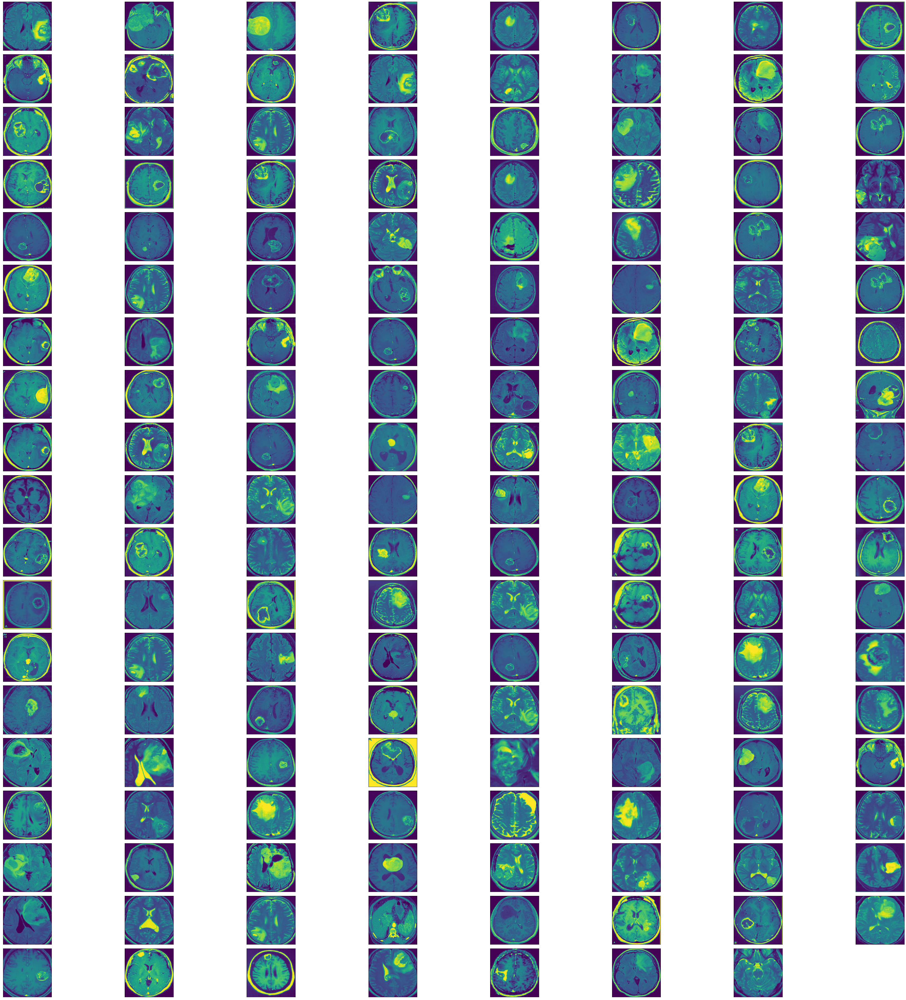

In [5]:
print('*' * 42 + ' tumor dataset (target = yes) '+ '*' * 42)
plt.figure(figsize=(50,50))
for i in range(len_tumor_yes):
    plt.subplot(19,8,i+1)
    plt.imshow(tumor_yes[i])
    plt.xticks([])
    plt.yticks([])
plt.tight_layout() 
plt.show()

In [6]:
mypath='no'
tumor_no = load_images(mypath)
len_tumor_no = len(tumor_no)
print(len_tumor_no)

89


****************************************** tumor dataset (target = no) ******************************************


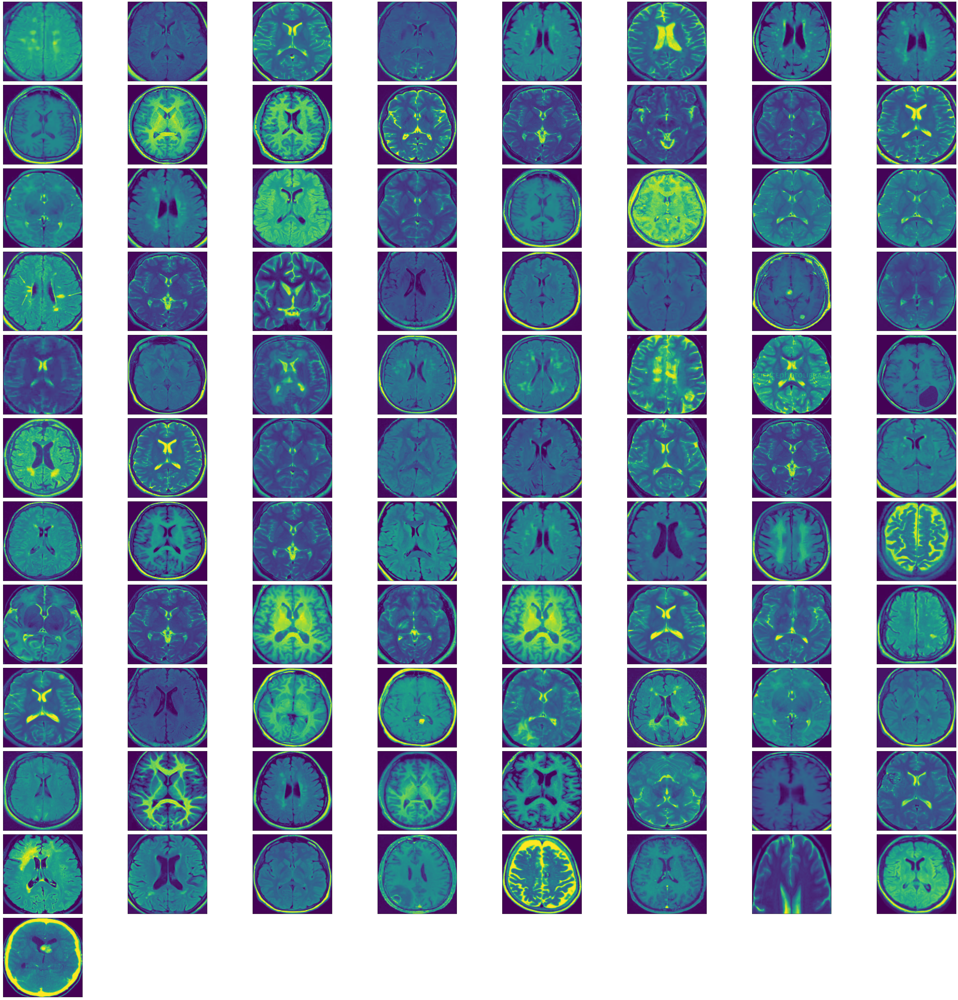

In [7]:
print('*' * 42 + ' tumor dataset (target = no) '+ '*' * 42)
plt.figure(figsize=(50,50))
for i in range(len_tumor_no):
    plt.subplot(12,8,i+1)
    plt.imshow(tumor_no[i])
    plt.xticks([])
    plt.yticks([])
plt.tight_layout() 
plt.show()

In [8]:
y_yes = np.ones(len_tumor_yes, dtype="int8")
y_no = np.zeros(len_tumor_no, dtype="int8")

X = np.concatenate((tumor_yes, tumor_no), axis=0)
y = np.concatenate((y_yes, y_no), axis=0)

d1, d2, d3 = X.shape

X = X.reshape((d1, d2 * d3))

In [9]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=10)

In [10]:
# scale data before train model
scaler_ = StandardScaler()
X_train_sc = scaler_.fit_transform(X_train)
X_test_sc = scaler_.transform(X_test)

In [11]:
# random forest without pca
rf_model = RandomForestClassifier()
rf_model.fit(X_train_sc, y_train)
y_predict = rf_model.predict(X_test_sc)

# PCA
data_pca = PCA(n_components=12)
pca_components = data_pca.fit(X_train_sc)
X_train_pca = pca_components.fit_transform(X_train_sc)
X_test_pca = pca_components.transform(X_test_sc)

# KernelPCA
data_kpca = KernelPCA()
kpca_components = data_kpca.fit(X_train_sc)
X_train_kpca = kpca_components.fit_transform(X_train_sc)
X_test_kpca = kpca_components.transform(X_test_sc)

# RandomForest With PCA
rf_model_pca = RandomForestClassifier()
rf_model_pca.fit(X_train_pca, y_train)
y_predict_pca = rf_model_pca.predict(X_test_pca)

# RandomForest With KernelPCA
rf_model_kpca = RandomForestClassifier()
rf_model_kpca.fit(X_train_kpca, y_train)
y_predict_kpca = rf_model_kpca.predict(X_test_kpca)

print("RandomForest without PCA:")
print(classification_report(y_test, y_predict))

print("RandomForest with PCA:")
print(classification_report(y_test, y_predict_pca))

print("RandomForest without KPCA:")
print(classification_report(y_test, y_predict_kpca))

RandomForest without PCA:
              precision    recall  f1-score   support

           0       0.76      0.46      0.58        28
           1       0.73      0.91      0.81        44

    accuracy                           0.74        72
   macro avg       0.75      0.69      0.69        72
weighted avg       0.74      0.74      0.72        72

RandomForest with PCA:
              precision    recall  f1-score   support

           0       0.81      0.61      0.69        28
           1       0.78      0.91      0.84        44

    accuracy                           0.79        72
   macro avg       0.80      0.76      0.77        72
weighted avg       0.79      0.79      0.78        72

RandomForest without KPCA:
              precision    recall  f1-score   support

           0       0.50      0.11      0.18        28
           1       0.62      0.93      0.75        44

    accuracy                           0.61        72
   macro avg       0.56      0.52      0.46        7